<div class="alert alert-block alert-info"><h1 style="text-align:center;color:black"> Sign Language Classification</h1> </div>

<a id="2"></a>
<div style="display:flex; justify-content:center; align-items:center; height:50vh;">
  <h2>Data Description</h2>
</div>

The data set is a collection of images of alphabets from the American Sign Language, separated in 36 folders which represent the various classes.

The data set contains 2515 images which are 400x400 pixels. There are 36 classes.

The 36 classes contain 0-9 and A-Z alphabets.

<a id="3"></a>
<div style="display:flex; justify-content:center; align-items:center; height:50vh;">
  <h2>Loading Libraries</h2>
</div>


In [2]:
%pip install split-folders

import os 
import re
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random

import splitfolders

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator


from keras.models import Sequential
from keras.layers import Dense,Conv2D,Dropout,Flatten,MaxPooling2D, BatchNormalization,Input,concatenate
from keras.callbacks import EarlyStopping,ReduceLROnPlateau
from keras.utils import plot_model

from sklearn.metrics import classification_report, confusion_matrix

import warnings
warnings.filterwarnings("ignore")

import wandb

import os

Note: you may need to restart the kernel to use updated packages.


In [3]:

base_path = "/kaggle/input/asl-dataset/asl_dataset/"
categories = {
    0: "0", 1: "1", 2: "2", 3: "3", 4: "4", 5: "5", 6: "6", 7: "7", 8: "8", 9: "9",
    10: "a", 11: "b", 12: "c", 13: "d", 14: "e", 15: "f", 16: "g", 17: "h", 18: "i",
    19: "j", 20: "k", 21: "l", 22: "m", 23: "n", 24: "o", 25: "p", 26: "q", 27: "r",
    28: "s", 29: "t", 30: "u", 31: "v", 32: "w", 33: "x", 34: "y", 35: "z"
}

filenames_list = []
categories_list = []

for category_idx, category_name in categories.items():
    folder_path = os.path.join(base_path, category_name)
    filenames = [f"{category_name}/{filename}" for filename in os.listdir(folder_path)]
    filenames_list.extend(filenames)
    categories_list.extend([category_name] * len(filenames))

df = pd.DataFrame({"filename": filenames_list, "category": categories_list})
df = df.sample(frac=1).reset_index(drop=True)

In [ ]:

print("number of elements = ", len(df))

In [ ]:
df

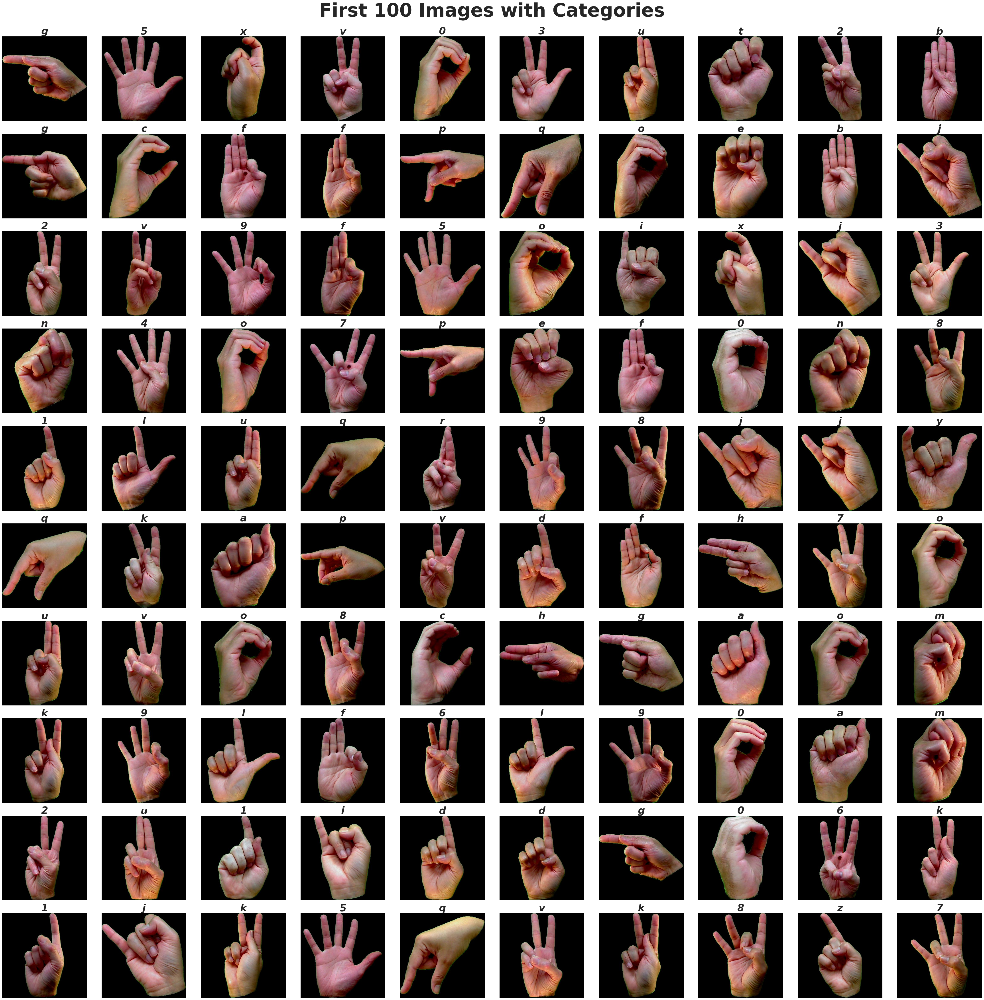

In [30]:
plt.figure(figsize=(45,45))

for i in range(100):
    path = base_path + df.filename[i]
    img = plt.imread(path)
    plt.subplot(10,10, i + 1)
    plt.imshow(img)
    plt.title(df.category[i], fontsize=32, fontstyle='italic',fontweight="bold")
    plt.axis("off")

plt.suptitle("First 100 Images with Categories", fontsize=60, fontweight="bold", y=1.0)
plt.tight_layout()
plt.show()


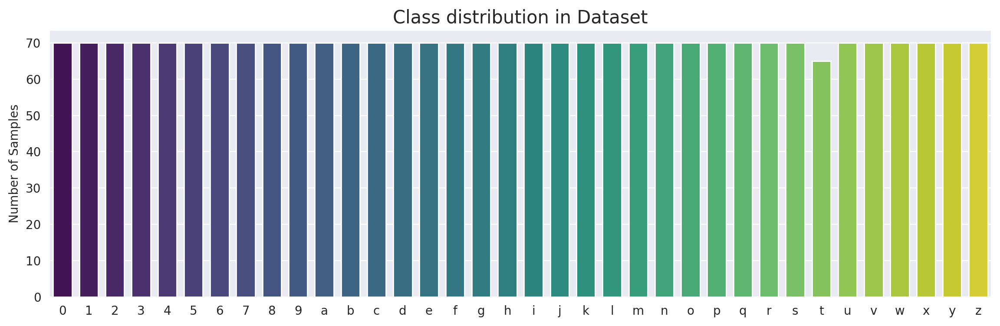

In [31]:
label,count = np.unique(df.category,return_counts=True)
uni = pd.DataFrame(data=count,index=categories.values(),columns=['Number of Samples'])

plt.figure(figsize=(14,4),dpi=200)
sns.barplot(data=uni,x=uni.index,y='Number of Samples',palette='viridis',width=0.72).set_title('Class distribution in Dataset',fontsize=15)
plt.show()


# ****Train Test Split****

We will split the data in three parts.

Training dataset (80%)
Validation dataset (10%)
Testing dataset (10%)

In [4]:
splitfolders.ratio('/kaggle/input/asl-dataset/asl_dataset',output='/kaggle/working/', seed=3, ratio=(0.8,0.1,0.1))

Copying files: 2515 files [00:04, 531.75 files/s]


In [5]:
import shutil
shutil.rmtree("/kaggle/working/train/asl_dataset")
shutil.rmtree("/kaggle/working/val/asl_dataset")
shutil.rmtree("/kaggle/working/test/asl_dataset")

<a id="6"></a>
<div style="display:flex; justify-content:center; align-items:center; height:50vh;">
  <h2>Data Augmentation</h2>
</div>

* Pixel normalization
* Zoom
* Brightss change

In [6]:
datagen = ImageDataGenerator(
    rescale=1./255,               
    zoom_range=0.1,              
    horizontal_flip=False,        
    brightness_range=[0.8,1.2],  
    fill_mode='nearest'          
)

In [7]:
# Configuration Parameters for Image Classification Model
# Set dataset paths and define key hyperparameters for training pipeline

train_path = '/kaggle/working/train'
val_path = '/kaggle/working/val'
test_path = '/kaggle/working/test'

batch = 32
image_size = 224
img_channel = 3
n_classes = 36

In [9]:
train_data = datagen.flow_from_directory(directory= train_path, 
                                         target_size=(image_size,image_size), 
                                         batch_size = batch, 
                                         class_mode='categorical')

val_data = datagen.flow_from_directory(directory= val_path, 
                                       target_size=(image_size,image_size), 
                                       batch_size = batch, 
                                       class_mode='categorical',
                                       )

test_data = datagen.flow_from_directory(directory= test_path, 
                                         target_size=(image_size,image_size), 
                                         batch_size = batch, 
                                         class_mode='categorical',
                                         shuffle= False)

Found 2012 images belonging to 36 classes.
Found 251 images belonging to 36 classes.
Found 252 images belonging to 36 classes.


# Check for corrupted images

In [ ]:
import numpy as np
import os
from PIL import Image

bad_files = []

for i in range(len(train_data.filenames)):
    filepath = os.path.join(train_data.directory, train_data.filenames[i])
    try:
        img = Image.open(filepath)
        img.verify() 
    except:
        bad_files.append(filepath)

print("Number of corrupted files:", len(bad_files))


# Create CNN Model

In [ ]:
model = Sequential()
# input layer
# Block 1
model.add(Conv2D(32,3,activation='relu',padding='same',input_shape = (image_size,image_size,img_channel)))
model.add(Conv2D(32,3,activation='relu',padding='same'))
#model.add(BatchNormalization())
model.add(MaxPooling2D(padding='same'))
model.add(Dropout(0.2))

# Block 2
model.add(Conv2D(64,3,activation='relu',padding='same'))
model.add(Conv2D(64,3,activation='relu',padding='same'))
#model.add(BatchNormalization())
model.add(MaxPooling2D(padding='same'))
model.add(Dropout(0.3))

#Block 3
model.add(Conv2D(128,3,activation='relu',padding='same'))
model.add(Conv2D(128,3,activation='relu',padding='same'))
#model.add(BatchNormalization())
model.add(MaxPooling2D(padding='same'))
model.add(Dropout(0.4))

# fully connected layer
model.add(Flatten())

model.add(Dense(512,activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(128,activation='relu'))
model.add(Dropout(0.3))

# output layer
model.add(Dense(36, activation='softmax'))



model.summary()

In [14]:
early_stoping = EarlyStopping(monitor='val_loss', 
                              min_delta=0.001,
                              patience= 5,
                              restore_best_weights= True, 
                              verbose = 0)

reduce_learning_rate = ReduceLROnPlateau(monitor='val_accuracy', 
                                         patience = 2, 
                                         factor=0.5 , 
                                         verbose = 1)



In [13]:
import tensorflow as tf
from tensorflow import keras
from keras import layers
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, BatchNormalization
import keras_tuner as kt

def build_model(hp):
    model = Sequential()
    
    # Input layer - using your variables
    model.add(Conv2D(
        hp.Int('block1_filters_1', min_value=16, max_value=64, step=16),
        hp.Choice('block1_kernel_1', values=[3, 5]),
        activation='relu',
        padding='same',
        input_shape=(image_size, image_size, img_channel)
    ))
    
    model.add(Conv2D(
        hp.Int('block1_filters_2', min_value=16, max_value=64, step=16),
        hp.Choice('block1_kernel_2', values=[3, 5]),
        activation='relu',
        padding='same'
    ))
    
    # Optional BatchNormalization
    if hp.Boolean('block1_batch_norm'):
        model.add(BatchNormalization())
    
    model.add(MaxPooling2D(padding='same'))
    model.add(Dropout(hp.Float('block1_dropout', min_value=0.1, max_value=0.5, step=0.1)))

    # Block 2
    model.add(Conv2D(
        hp.Int('block2_filters_1', min_value=32, max_value=128, step=32),
        hp.Choice('block2_kernel_1', values=[3, 5]),
        activation='relu',
        padding='same'
    ))
    
    model.add(Conv2D(
        hp.Int('block2_filters_2', min_value=32, max_value=128, step=32),
        hp.Choice('block2_kernel_2', values=[3, 5]),
        activation='relu',
        padding='same'
    ))
    
    # Optional BatchNormalization
    if hp.Boolean('block2_batch_norm'):
        model.add(BatchNormalization())
    
    model.add(MaxPooling2D(padding='same'))
    model.add(Dropout(hp.Float('block2_dropout', min_value=0.1, max_value=0.5, step=0.1)))

    # Block 3
    model.add(Conv2D(
        hp.Int('block3_filters_1', min_value=64, max_value=256, step=64),
        hp.Choice('block3_kernel_1', values=[3, 5]),
        activation='relu',
        padding='same'
    ))
    
    model.add(Conv2D(
        hp.Int('block3_filters_2', min_value=64, max_value=256, step=64),
        hp.Choice('block3_kernel_2', values=[3, 5]),
        activation='relu',
        padding='same'
    ))
    
    # Optional BatchNormalization
    if hp.Boolean('block3_batch_norm'):
        model.add(BatchNormalization())
    
    model.add(MaxPooling2D(padding='same'))
    model.add(Dropout(hp.Float('block3_dropout', min_value=0.1, max_value=0.6, step=0.1)))

    # Fully connected layers
    model.add(Flatten())

    # First dense layer
    model.add(Dense(
        hp.Int('dense1_units', min_value=256, max_value=1024, step=128),
        activation='relu'
    ))
    model.add(Dropout(hp.Float('dense1_dropout', min_value=0.1, max_value=0.5, step=0.1)))
    
    # Second dense layer
    model.add(Dense(
        hp.Int('dense2_units', min_value=64, max_value=512, step=64),
        activation='relu'
    ))
    model.add(Dropout(hp.Float('dense2_dropout', min_value=0.1, max_value=0.5, step=0.1)))

    # Output layer (36 classes for ASL)
    model.add(Dense(36, activation='softmax'))

    # Hyperparameter: learning rate
    lr = hp.Float('learning_rate', min_value=1e-5, max_value=1e-2, sampling='LOG')

    # Hyperparameter: optimizer selection
    optimizer_name = hp.Choice('optimizer', values=['adam', 'rmsprop', 'sgd'])
    if optimizer_name == 'adam':
        optimizer = keras.optimizers.Adam(learning_rate=lr)
    elif optimizer_name == 'rmsprop':
        optimizer = keras.optimizers.RMSprop(learning_rate=lr)
    else:
        optimizer = keras.optimizers.SGD(learning_rate=lr, momentum=0.9)

    model.compile(
        optimizer=optimizer,
        loss='categorical_crossentropy',
        metrics=['accuracy']
    )
    
    return model

# Custom tuner class to handle batch size
class MyTuner(kt.RandomSearch):
    def run_trial(self, trial, *args, **kwargs):
        # Get batch size hyperparameter
        kwargs['batch_size'] = trial.hyperparameters.Int('batch_size', min_value=16, max_value=128, step=16)
        return super(MyTuner, self).run_trial(trial, *args, **kwargs)

# Create the tuner
tuner = MyTuner(
    build_model,
    objective='val_accuracy',
    max_trials=4,  # Increase for better results
    executions_per_trial=1,
    directory='asl_tuner',
    project_name='asl_hyperparameter_optimization'
)

# Display search space summary
print("Search space summary:")
tuner.search_space_summary()

# Start the search
print("Starting hyperparameter search...")
tuner.search(
    train_data,
    validation_data=val_data,
    epochs=15,
    callbacks=[early_stoping, reduce_learning_rate],
    verbose=1
)

# Get the best hyperparameters
best_hp = tuner.get_best_hyperparameters(num_trials=1)[0]

print("\n" + "="*50)
print("BEST HYPERPARAMETERS FOUND:")
print("="*50)

# Block 1 parameters
print(f"Block 1 - Conv1 Filters: {best_hp.get('block1_filters_1')}")
print(f"Block 1 - Conv1 Kernel: {best_hp.get('block1_kernel_1')}")
print(f"Block 1 - Conv2 Filters: {best_hp.get('block1_filters_2')}")
print(f"Block 1 - Conv2 Kernel: {best_hp.get('block1_kernel_2')}")
print(f"Block 1 - BatchNorm: {best_hp.get('block1_batch_norm')}")
print(f"Block 1 - Dropout: {best_hp.get('block1_dropout')}")

# Block 2 parameters
print(f"Block 2 - Conv1 Filters: {best_hp.get('block2_filters_1')}")
print(f"Block 2 - Conv1 Kernel: {best_hp.get('block2_kernel_1')}")
print(f"Block 2 - Conv2 Filters: {best_hp.get('block2_filters_2')}")
print(f"Block 2 - Conv2 Kernel: {best_hp.get('block2_kernel_2')}")
print(f"Block 2 - BatchNorm: {best_hp.get('block2_batch_norm')}")
print(f"Block 2 - Dropout: {best_hp.get('block2_dropout')}")

# Block 3 parameters
print(f"Block 3 - Conv1 Filters: {best_hp.get('block3_filters_1')}")
print(f"Block 3 - Conv1 Kernel: {best_hp.get('block3_kernel_1')}")
print(f"Block 3 - Conv2 Filters: {best_hp.get('block3_filters_2')}")
print(f"Block 3 - Conv2 Kernel: {best_hp.get('block3_kernel_2')}")
print(f"Block 3 - BatchNorm: {best_hp.get('block3_batch_norm')}")
print(f"Block 3 - Dropout: {best_hp.get('block3_dropout')}")

# Dense layer parameters
print(f"Dense 1 Units: {best_hp.get('dense1_units')}")
print(f"Dense 1 Dropout: {best_hp.get('dense1_dropout')}")
print(f"Dense 2 Units: {best_hp.get('dense2_units')}")
print(f"Dense 2 Dropout: {best_hp.get('dense2_dropout')}")

# Training parameters
print(f"Learning Rate: {best_hp.get('learning_rate')}")
print(f"Optimizer: {best_hp.get('optimizer')}")
print(f"Batch Size: {best_hp.get('batch_size')}")

# Get the best model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.summary()

# Train the best model with the optimized hyperparameters
print("\nTraining the best model...")
asl_class = best_model.fit(
    train_data,
    validation_data=val_data,
    epochs=18,  # Train longer with the best hyperparameters
    callbacks=[early_stoping, reduce_learning_rate],
    verbose=1
)

# Save the best model
best_model.save('best_asl_model.h5')
print("Best model saved as 'best_asl_model.h5'")

Trial 5 Complete [00h 08m 06s]
val_accuracy: 0.8725099563598633

Best val_accuracy So Far: 0.9681274890899658
Total elapsed time: 00h 56m 41s

BEST HYPERPARAMETERS FOUND:
Block 1 - Conv1 Filters: 32
Block 1 - Conv1 Kernel: 3
Block 1 - Conv2 Filters: 64
Block 1 - Conv2 Kernel: 5
Block 1 - BatchNorm: False
Block 1 - Dropout: 0.1
Block 2 - Conv1 Filters: 64
Block 2 - Conv1 Kernel: 5
Block 2 - Conv2 Filters: 128
Block 2 - Conv2 Kernel: 3
Block 2 - BatchNorm: False
Block 2 - Dropout: 0.4
Block 3 - Conv1 Filters: 256
Block 3 - Conv1 Kernel: 5
Block 3 - Conv2 Filters: 128
Block 3 - Conv2 Kernel: 3
Block 3 - BatchNorm: True
Block 3 - Dropout: 0.1
Dense 1 Units: 640
Dense 1 Dropout: 0.1
Dense 2 Units: 448
Dense 2 Dropout: 0.30000000000000004
Learning Rate: 0.0009822776159057948
Optimizer: adam
Batch Size: 16


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 224, 224, 64)   │        51,264 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 112, 112, 64)   │       102,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 56, 56, 256)    │       819,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 56, 56, 128)    │       295,040 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 56, 56, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 28, 28, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 100352)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 640)            │    64,225,920 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 640)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 448)            │       287,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 448)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 36)             │        16,164 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 65,872,740 (251.28 MB)

 Trainable params: 65,872,484 (251.28 MB)

 Non-trainable params: 256 (1.00 KB)


Training the best model...
Epoch 1/18


2025-09-26 18:19:16.318622: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[32,32,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,224,224]{3,2,1,0}, f32[64,32,5,5]{3,2,1,0}), window={size=5x5 pad=2_2x2_2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]} is taking a while...
2025-09-26 18:19:16.975261: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.656758691s
Trying algorithm eng0{} for conv (f32[32,32,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,64,224,224]{3,2,1,0}, f32[64,32,5,5]{3,2,1,0}), window={size=5x5 pad=2_2x2_2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activ

29/63 ━━━━━━━━━━━━━━━━━━━━ 13s 407ms/step - accuracy: 0.9683 - loss: 0.1613

2025-09-26 18:19:46.016937: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[28,32,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[28,64,224,224]{3,2,1,0}, f32[64,32,5,5]{3,2,1,0}), window={size=5x5 pad=2_2x2_2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]} is taking a while...
2025-09-26 18:19:46.476527: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.459706942s
Trying algorithm eng0{} for conv (f32[28,32,224,224]{3,2,1,0}, u8[0]{0}) custom-call(f32[28,64,224,224]{3,2,1,0}, f32[64,32,5,5]{3,2,1,0}), window={size=5x5 pad=2_2x2_2}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardInput", backend_config={"cudnn_conv_backend_config":{"activ

63/63 ━━━━━━━━━━━━━━━━━━━━ 78s 881ms/step - accuracy: 0.9592 - loss: 0.1695 - val_accuracy: 0.8884 - val_loss: 0.7961 - learning_rate: 9.8228e-04
Epoch 2/18
63/63 ━━━━━━━━━━━━━━━━━━━━ 28s 446ms/step - accuracy: 0.9423 - loss: 0.1753 - val_accuracy: 0.8645 - val_loss: 0.5568 - learning_rate: 9.8228e-04
Epoch 3/18
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 404ms/step - accuracy: 0.9362 - loss: 0.2775
Epoch 3: ReduceLROnPlateau reducing learning rate to 0.0004911387804895639.
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 454ms/step - accuracy: 0.9361 - loss: 0.2788 - val_accuracy: 0.4821 - val_loss: 12.6070 - learning_rate: 9.8228e-04
Epoch 4/18
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 462ms/step - accuracy: 0.9416 - loss: 0.1797 - val_accuracy: 0.9203 - val_loss: 0.3142 - learning_rate: 4.9114e-04
Epoch 5/18
63/63 ━━━━━━━━━━━━━━━━━━━━ 28s 436ms/step - accuracy: 0.9771 - loss: 0.0743 - val_accuracy: 0.9323 - val_loss: 0.4178 - learning_rate: 4.9114e-04
Epoch 6/18
63/63 ━━━━━━━━━━━━━━━━━━━━ 28s 447ms/step - accuracy: 0.9894 - 

**Use gpu for fast training**

In [15]:
import tensorflow as tf

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  2


In [16]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth enabled")
    except RuntimeError as e:
        print(e)

Physical devices cannot be modified after being initialized


# Model Training

In [17]:
asl_class = best_model.fit(train_data, 
                      validation_data= val_data, 
                      epochs=30, 
                      callbacks=[early_stoping,reduce_learning_rate],
                      verbose = 1)

Epoch 1/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 30s 472ms/step - accuracy: 0.9840 - loss: 0.0491 - val_accuracy: 0.9283 - val_loss: 0.3524 - learning_rate: 1.2278e-04
Epoch 2/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 455ms/step - accuracy: 0.9887 - loss: 0.0354 - val_accuracy: 0.9363 - val_loss: 0.2515 - learning_rate: 1.2278e-04
Epoch 3/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 462ms/step - accuracy: 0.9911 - loss: 0.0333 - val_accuracy: 0.9283 - val_loss: 0.2181 - learning_rate: 1.2278e-04
Epoch 4/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 453ms/step - accuracy: 0.9893 - loss: 0.0225 - val_accuracy: 0.9402 - val_loss: 0.2836 - learning_rate: 1.2278e-04
Epoch 5/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 451ms/step - accuracy: 0.9989 - loss: 0.0087 - val_accuracy: 0.9283 - val_loss: 0.2966 - learning_rate: 1.2278e-04
Epoch 6/30
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 403ms/step - accuracy: 0.9954 - loss: 0.0110
Epoch 6: ReduceLROnPlateau reducing learning rate to 6.139234756119549e-05.
63/63 ━━━━━━━━━━━━━━━━━━━━ 29s 454ms/step - accuracy:

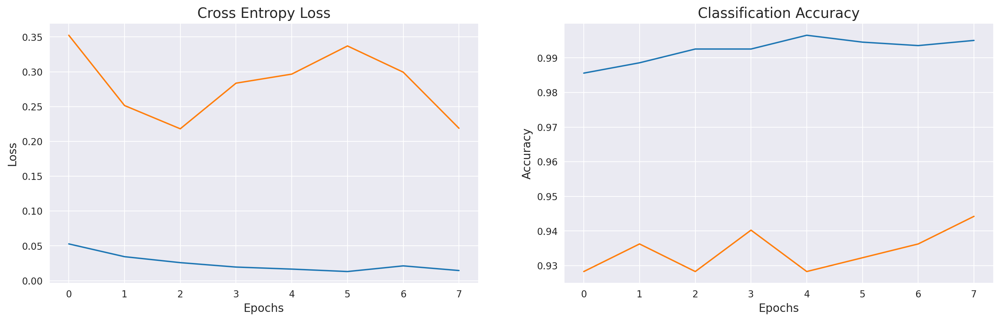

In [22]:
# plots for accuracy and Loss with epochs

error = pd.DataFrame(asl_class.history)

plt.figure(figsize=(18,5),dpi=200)
sns.set_style('darkgrid')

plt.subplot(121)
plt.title('Cross Entropy Loss',fontsize=15)
plt.xlabel('Epochs',fontsize=12)
plt.ylabel('Loss',fontsize=12)
plt.plot(error['loss'])
plt.plot(error['val_loss'])

plt.subplot(122)
plt.title('Classification Accuracy',fontsize=15)
plt.xlabel('Epochs',fontsize=12)
plt.ylabel('Accuracy',fontsize=12)
plt.plot(error['accuracy'])
plt.plot(error['val_accuracy'])

plt.show()

🎯 Model performansı değerlendiriliyor...
🔮 Test seti üzerinde tahmin yapılıyor...
8/8 ━━━━━━━━━━━━━━━━━━━━ 10s 1s/step 

📊 Test Seti Performansı:
   Test Accuracy: 0.9563 (95.63%)

📊 Confusion Matrix hesaplanıyor...


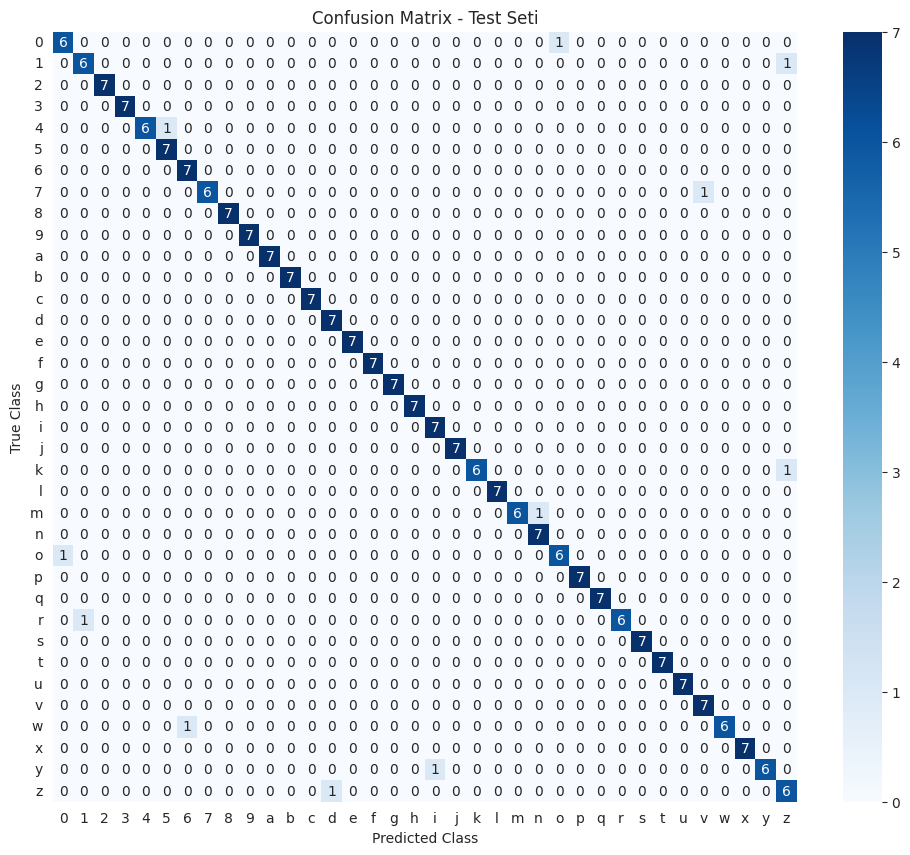


📊 Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.86      0.86         7
           1       0.86      0.86      0.86         7
           2       1.00      1.00      1.00         7
           3       1.00      1.00      1.00         7
           4       1.00      0.86      0.92         7
           5       0.88      1.00      0.93         7
           6       0.88      1.00      0.93         7
           7       1.00      0.86      0.92         7
           8       1.00      1.00      1.00         7
           9       1.00      1.00      1.00         7
           a       1.00      1.00      1.00         7
           b       1.00      1.00      1.00         7
           c       1.00      1.00      1.00         7
           d       0.88      1.00      0.93         7
           e       1.00      1.00      1.00         7
           f       1.00      1.00      1.00         7
           g       1.00      1.00      1.00         7
 

In [24]:
# 🎯 Model Performansını Değerlendirme
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
import seaborn as sns

print("🎯 Model performansı değerlendiriliyor...")



# Test seti üzerinde tahmin yap
print("🔮 Test seti üzerinde tahmin yapılıyor...")
test_predictions = best_model.predict(test_data, verbose=1)
test_pred_classes = np.argmax(test_predictions, axis=1)
test_true_classes = test_data.labels

# Genel accuracy
test_accuracy = accuracy_score(test_true_classes, test_pred_classes)
print(f"\n📊 Test Seti Performansı:")
print(f"   Test Accuracy: {test_accuracy:.4f} ({test_accuracy*100:.2f}%)")

# Confusion Matrix
print(f"\n📊 Confusion Matrix hesaplanıyor...")
cm = confusion_matrix(test_true_classes, test_pred_classes)
num_classes = 36
# Confusion Matrix görselleştirme
plt.figure(figsize=(12, 10))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=list(categories.values()), 
            yticklabels=list(categories.values()))
plt.title('Confusion Matrix - Test Seti')
plt.xlabel('Predicted Class')
plt.ylabel('True Class')
plt.xticks(rotation=0)
plt.yticks(rotation=0)
plt.show()

# Classification Report
print(f"\n📊 Classification Report:")
print(classification_report(test_true_classes, test_pred_classes, 
                          target_names=[f'{list(categories.values())[i]}' for i in range(num_classes)]))

# En iyi ve en kötü performans gösteren sınıflar
class_accuracies = []
for i in range(num_classes):
    class_mask = test_true_classes == i
    if np.sum(class_mask) > 0:
        class_acc = accuracy_score(test_true_classes[class_mask], test_pred_classes[class_mask])
        class_accuracies.append((i, class_acc, np.sum(class_mask)))
    else:
        class_accuracies.append((i, 0, 0))

# Sınıf performanslarını sırala
class_accuracies.sort(key=lambda x: x[1], reverse=True)

print(f"\n🏆 En İyi Performans Gösteren Sınıflar (Top 10):")
for i, (class_id, acc, count) in enumerate(class_accuracies[:10]):
    if count > 0:
        print(f"   {i+1:2d}. Sınıf {list(categories.values())[class_id]}: {acc:.4f} ({acc*100:.2f}%) - {count} örnek")

print(f"\n❌ En Kötü Performans Gösteren Sınıflar (Bottom 5):")
for i, (class_id, acc, count) in enumerate(class_accuracies[-5:]):
    if count > 0:
        print(f"   {i+1:2d}. Sınıf {list(categories.values())[class_id]}: {acc:.4f} ({acc*100:.2f}%) - {count} örnek")

Using last Conv2D layer for Grad-CAM: conv2d_5

Processing image 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


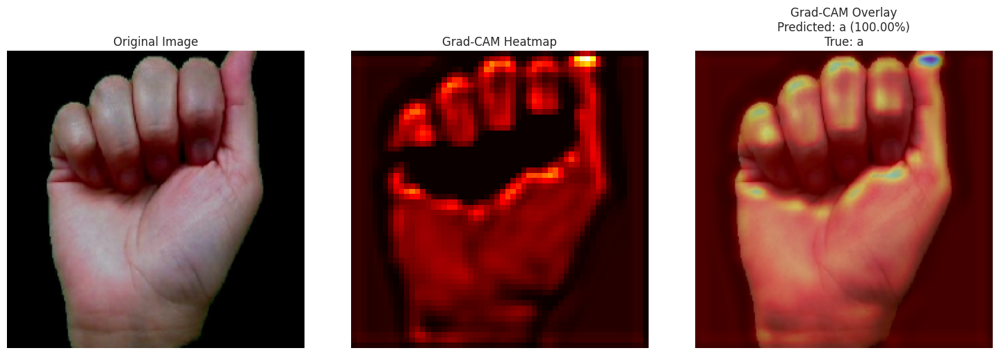


Processing image 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


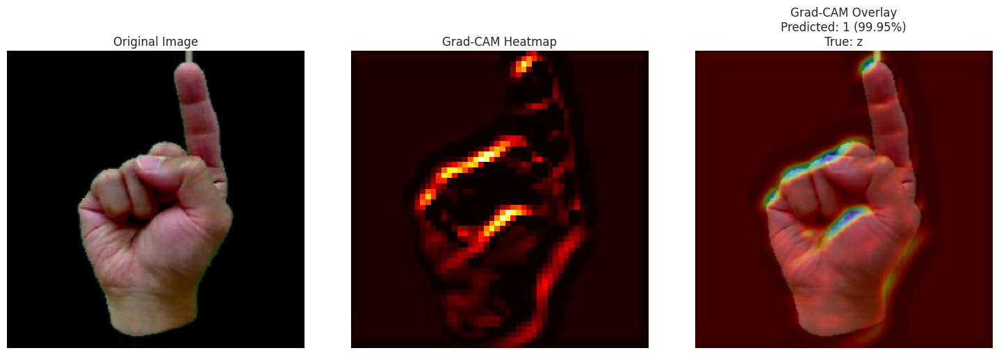


Processing image 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


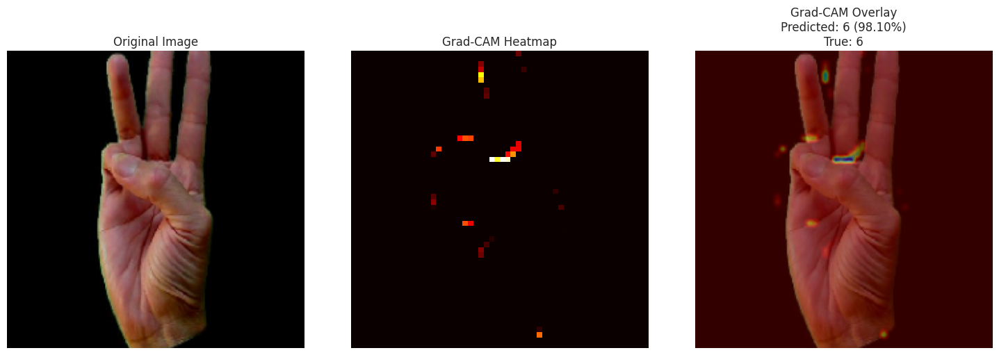


Processing image 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


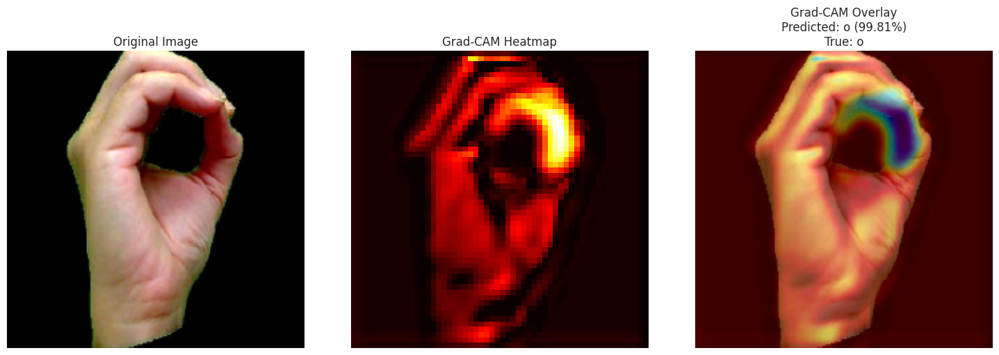


Processing image 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


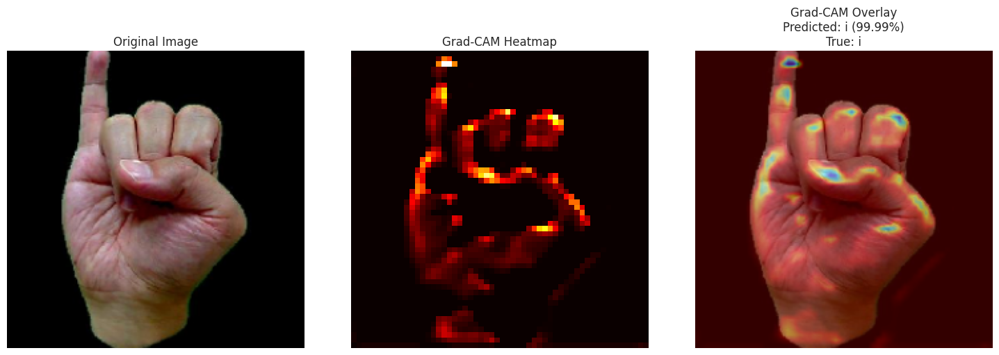


Processing image 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step


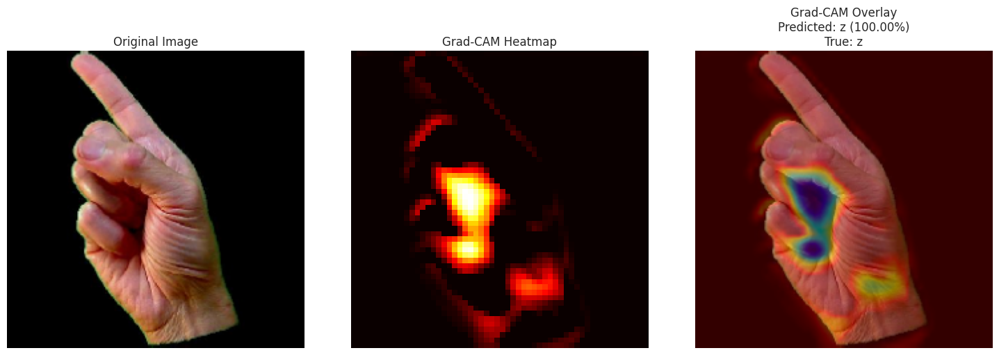


Processing image 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


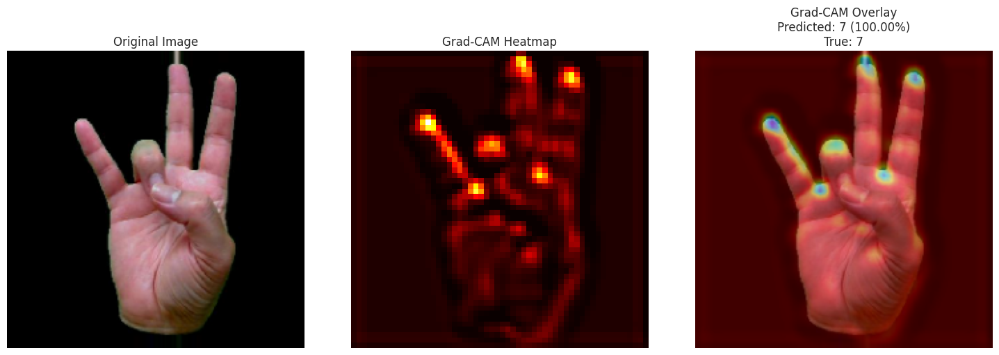


Processing image 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step


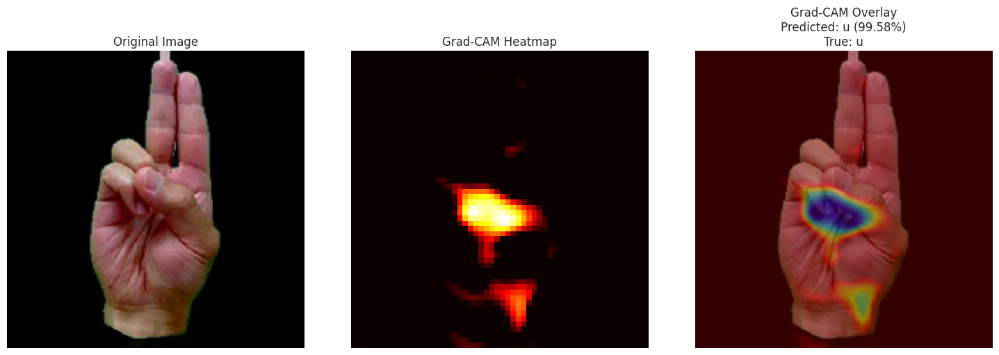


Processing image 9/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


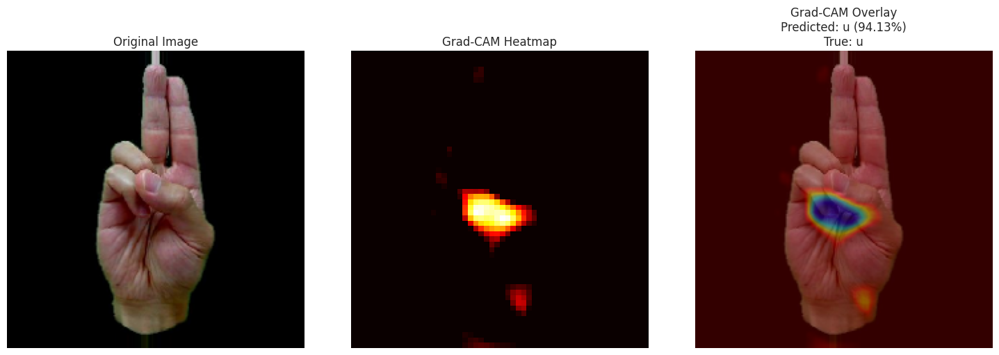


Processing image 10/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


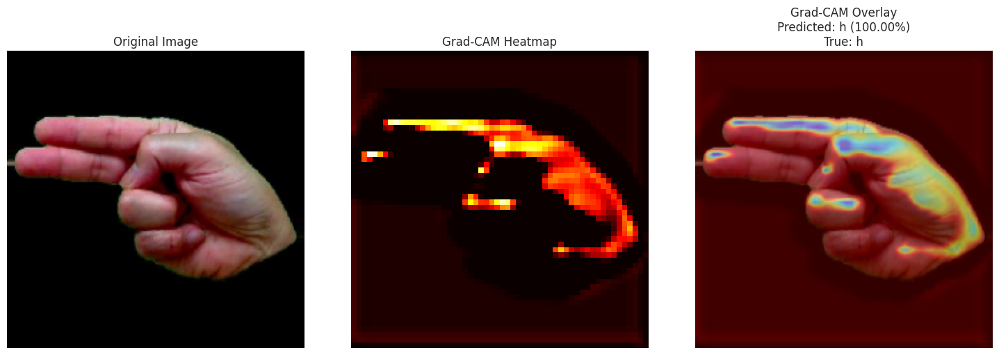

In [26]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import cv2

def make_gradcam_heatmap_robust(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Robust Grad-CAM implementation that works with any model type.
    
    Args:
        img_array: Input image array (batch_size, height, width, channels)
        model: The trained model
        last_conv_layer_name: Name of the last convolutional layer
        pred_index: Index of the class to visualize (None for predicted class)
    
    Returns:
        heatmap: Grad-CAM heatmap as numpy array
    """
    # First, ensure we can get predictions from the model
    predictions = model.predict(img_array)
    if pred_index is None:
        pred_index = np.argmax(predictions[0])
    
    # Find the last conv layer
    last_conv_layer = None
    last_conv_layer_idx = None
    
    for idx, layer in enumerate(model.layers):
        if layer.name == last_conv_layer_name:
            last_conv_layer = layer
            last_conv_layer_idx = idx
            break
    
    if last_conv_layer is None:
        raise ValueError(f"Layer {last_conv_layer_name} not found in model")
    
    # Create a new functional model for gradient computation
    # This approach works regardless of whether the original model has been called
    
    # Build intermediate model up to conv layer
    grad_model_input = tf.keras.Input(shape=img_array.shape[1:])
    x = grad_model_input
    
    # Apply all layers up to and including the last conv layer
    for layer in model.layers[:last_conv_layer_idx + 1]:
        x = layer(x)
    
    conv_output = x
    
    # Apply remaining layers
    for layer in model.layers[last_conv_layer_idx + 1:]:
        x = layer(x)
    
    model_output = x
    
    # Create the gradient model
    grad_model = tf.keras.Model(inputs=grad_model_input, outputs=[conv_output, model_output])
    
    # Compute gradients
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        class_channel = predictions[:, pred_index]
    
    # Calculate gradients
    grads = tape.gradient(class_channel, conv_outputs)
    
    # Pool the gradients
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    # Weight the conv outputs
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
    # ReLU and normalize
    heatmap = tf.maximum(heatmap, 0)
    if tf.math.reduce_max(heatmap) > 0:
        heatmap = heatmap / tf.math.reduce_max(heatmap)
    
    return heatmap.numpy()

def superimpose_gradcam(img, heatmap, alpha=0.4):
    """
    Superimpose Grad-CAM heatmap on the original image.
    
    Args:
        img: Original image
        heatmap: Grad-CAM heatmap
        alpha: Transparency for overlay
    
    Returns:
        superimposed_img: Image with heatmap overlay
    """
    # Resize heatmap to match original image size
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    
    # Convert heatmap to RGB
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    
    # Convert image to uint8 if needed
    if img.dtype != np.uint8:
        if img.max() <= 1.0:
            img = np.uint8(255 * img)
        else:
            img = np.uint8(img)
    
    # Superimpose the heatmap on original image
    superimposed_img = cv2.addWeighted(img, 1-alpha, heatmap, alpha, 0)
    
    return superimposed_img

def visualize_gradcam(model, img_array, img_original, last_conv_layer_name, 
                      pred_index=None, true_label=None, class_names=None):
    """
    Complete Grad-CAM visualization pipeline.
    
    Args:
        model: Trained model
        img_array: Preprocessed image array for model input
        img_original: Original image for visualization
        last_conv_layer_name: Name of last conv layer
        pred_index: Class index to visualize
        true_label: True label of the image
        class_names: List of class names
    """
    # Generate heatmap using robust method
    heatmap = make_gradcam_heatmap_robust(img_array, model, last_conv_layer_name, pred_index)
    
    # Get predictions
    predictions = model.predict(img_array)
    predicted_class = np.argmax(predictions[0])
    confidence = predictions[0][predicted_class]
    
    # Superimpose heatmap on image
    superimposed_img = superimpose_gradcam(img_original, heatmap)
    
    # Create visualization
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    
    # Original image
    if img_original.max() <= 1:
        axes[0].imshow(img_original)
    else:
        axes[0].imshow(img_original.astype(np.uint8))
    axes[0].set_title('Original Image')
    axes[0].axis('off')
    
    # Heatmap
    axes[1].imshow(heatmap, cmap='hot')
    axes[1].set_title('Grad-CAM Heatmap')
    axes[1].axis('off')
    
    # Superimposed
    axes[2].imshow(superimposed_img)
    title = f'Grad-CAM Overlay\nPredicted: '
    if class_names:
        title += f'{class_names[predicted_class]}'
    else:
        title += f'Class {predicted_class}'
    title += f' ({confidence:.2%})'
    if true_label is not None:
        title += f'\nTrue: '
        if class_names:
            title += f'{class_names[true_label]}'
        else:
            title += f'Class {true_label}'
    axes[2].set_title(title)
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

# Find the last Conv2D layer automatically
def find_last_conv_layer(model):
    """Find the name of the last Conv2D layer in the model."""
    conv_layers = []
    for layer in model.layers:
        if isinstance(layer, tf.keras.layers.Conv2D):
            conv_layers.append(layer.name)
        # Also check inside Sequential/Functional models
        elif hasattr(layer, 'layers'):
            for sublayer in layer.layers:
                if isinstance(sublayer, tf.keras.layers.Conv2D):
                    conv_layers.append(sublayer.name)
    
    if not conv_layers:
        raise ValueError("No Conv2D layers found in the model")
    
    return conv_layers[-1]

# ===================== SIMPLE USAGE =====================
def simple_gradcam(model, val_data, num_samples=1):
    """
    Simple function to run Grad-CAM visualization.
    
    Args:
        model: Your trained model
        val_data: Validation data generator
        num_samples: Number of samples to visualize
    """
    # Find last conv layer
    last_conv_layer_name = find_last_conv_layer(model)
    print(f"Using last Conv2D layer for Grad-CAM: {last_conv_layer_name}")
    
    # Get a batch of validation data
    img_batch, label_batch = next(val_data)
    
    # Process each sample
    for i in range(min(num_samples, len(img_batch))):
        img_original = img_batch[i]
        true_label = np.argmax(label_batch[i]) if len(label_batch.shape) > 1 else label_batch[i]
        
        # Prepare image for model (add batch dimension)
        img_array = np.expand_dims(img_original, axis=0)
        
        print(f"\nProcessing image {i+1}/{num_samples}")
        
        # Generate and visualize Grad-CAM
        visualize_gradcam(
            model=model,
            img_array=img_array,
            img_original=img_original,
            last_conv_layer_name=last_conv_layer_name,
            pred_index=None,  # None to use predicted class
            true_label=true_label,
            class_names=list(categories.values())  # Add your class names here if available
        )

# ===================== MAIN EXECUTION =====================
if __name__ == "__main__":
    simple_gradcam(best_model, val_data, num_samples=10)

Model analizi yapılıyor...
Model Katman Analizi:
Layer 0: conv2d (Conv2D)
  Output shape: (None, 224, 224, 32)
  ✓ 4D çıktı bulundu!

Layer 1: conv2d_1 (Conv2D)
  Output shape: (None, 224, 224, 64)
  ✓ 4D çıktı bulundu!

Layer 2: max_pooling2d (MaxPooling2D)
  Output shape: (None, 112, 112, 64)
  ✓ 4D çıktı bulundu!

Layer 3: dropout (Dropout)
  Output shape: (None, 112, 112, 64)
  ✓ 4D çıktı bulundu!

Layer 4: conv2d_2 (Conv2D)
  Output shape: (None, 112, 112, 64)
  ✓ 4D çıktı bulundu!

Layer 5: conv2d_3 (Conv2D)
  Output shape: (None, 112, 112, 128)
  ✓ 4D çıktı bulundu!

Layer 6: max_pooling2d_1 (MaxPooling2D)
  Output shape: (None, 56, 56, 128)
  ✓ 4D çıktı bulundu!

Layer 7: dropout_1 (Dropout)
  Output shape: (None, 56, 56, 128)
  ✓ 4D çıktı bulundu!

Layer 8: conv2d_4 (Conv2D)
  Output shape: (None, 56, 56, 256)
  ✓ 4D çıktı bulundu!

Layer 9: conv2d_5 (Conv2D)
  Output shape: (None, 56, 56, 128)
  ✓ 4D çıktı bulundu!

Layer 10: batch_normalization (BatchNormalization)
  Output 

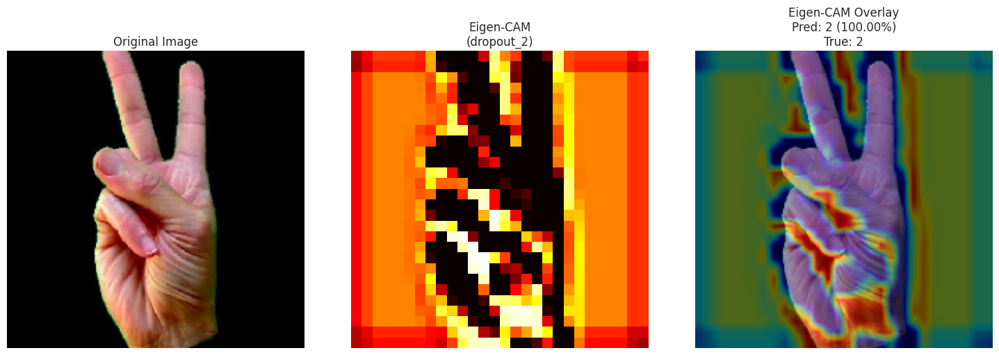


Image 2/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


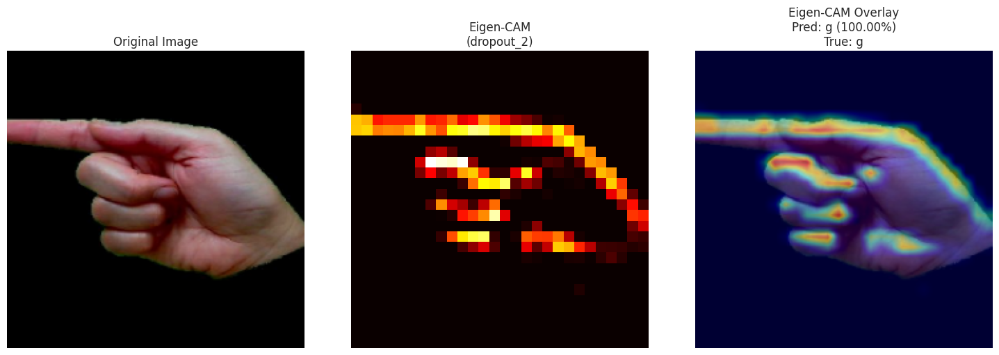


Image 3/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


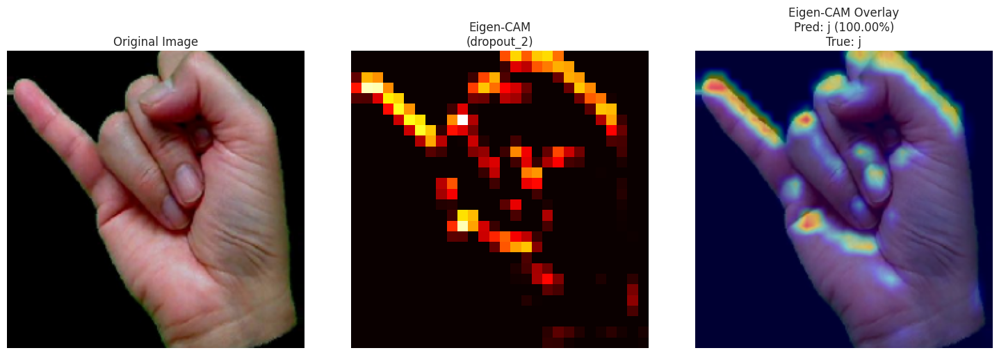


Image 4/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


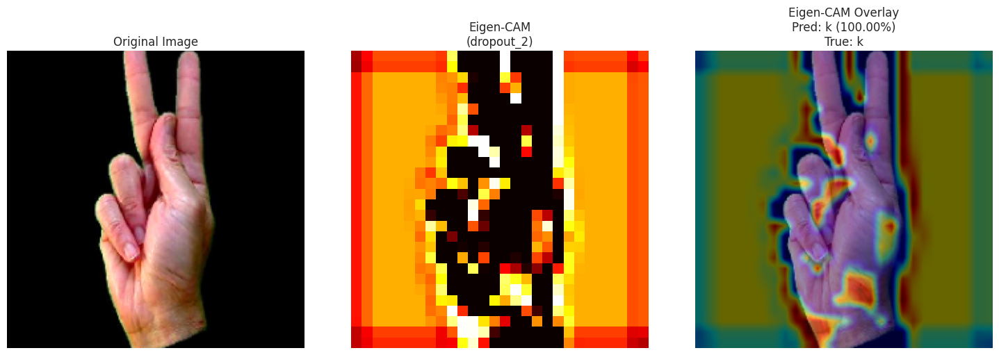


Image 5/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


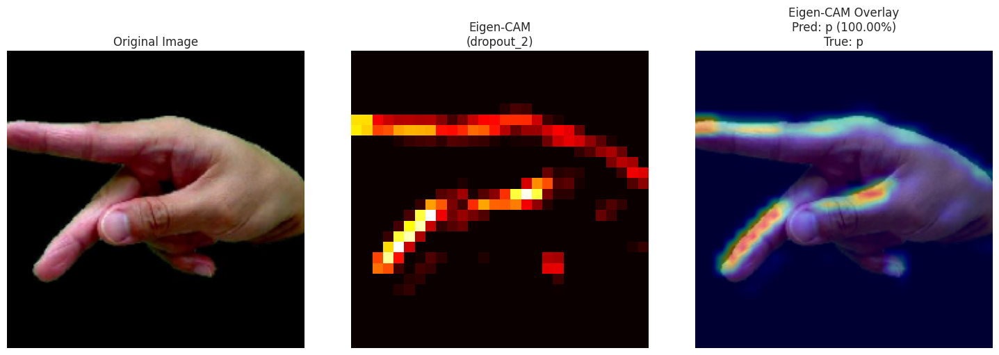


Image 6/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


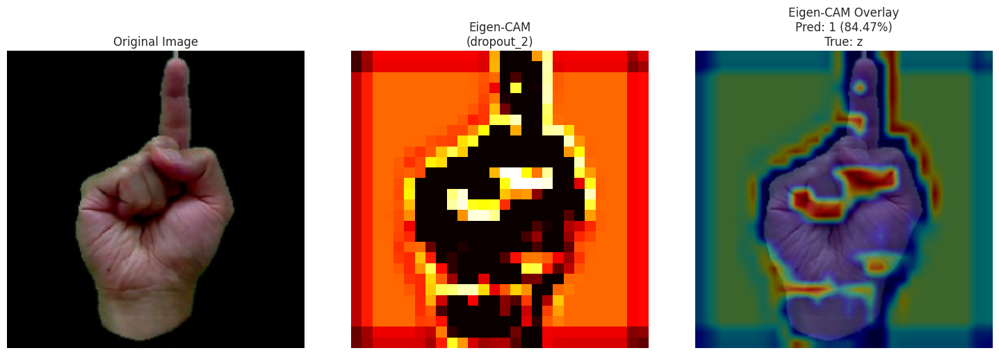


Image 7/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


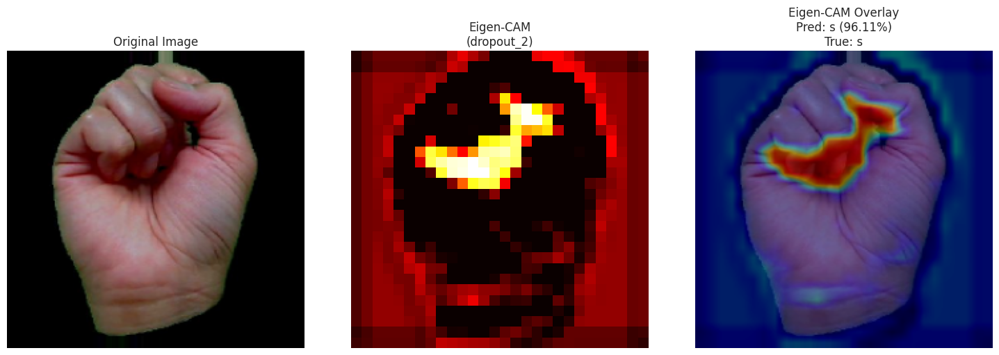


Image 8/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


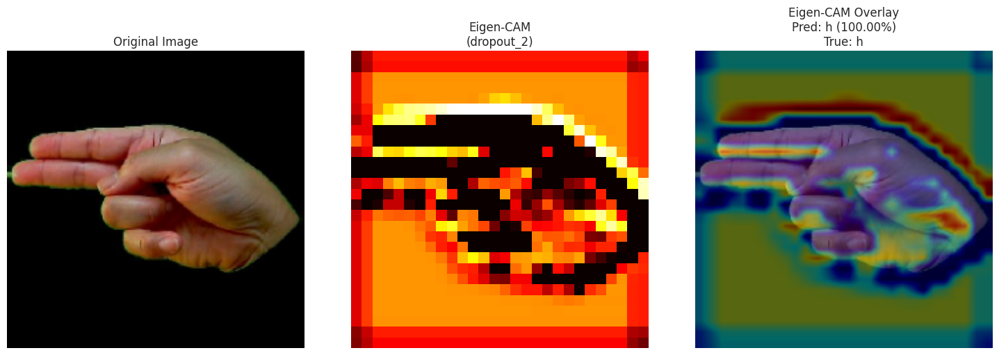


Image 9/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


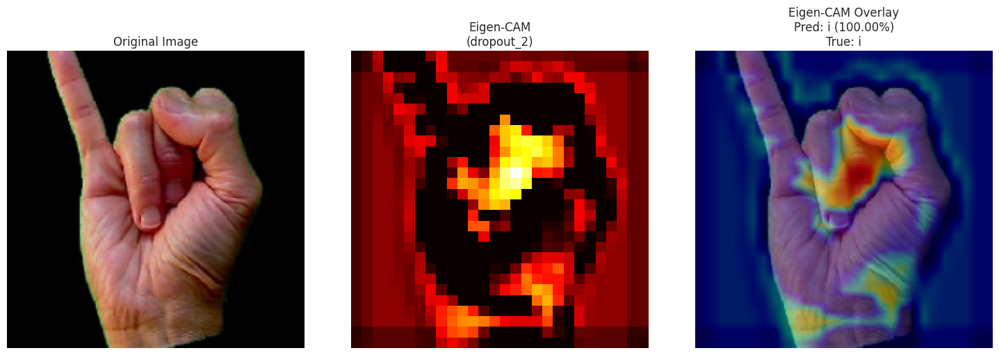


Image 10/10 işleniyor...
Input shape: (1, 224, 224, 3)
Heatmap oluşturuldu: (28, 28)


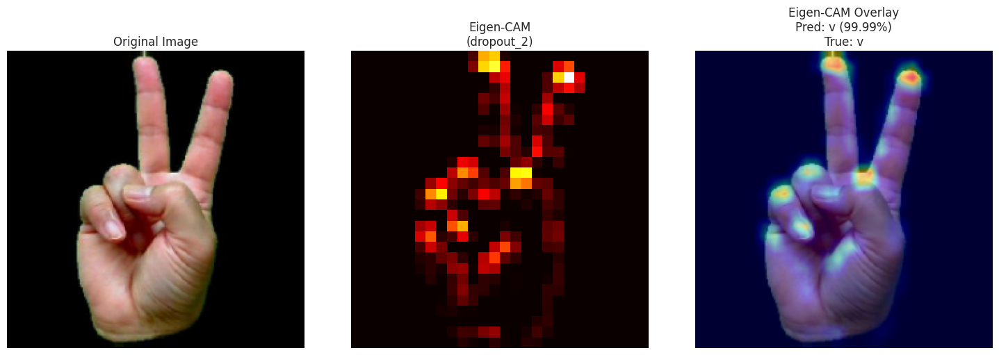

In [27]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import cv2

def inspect_model_layers(model):
    """
    Model katmanlarını detaylı şekilde inceler ve 4D çıktı üretenleri listeler.
    """
    print("Model Katman Analizi:")
    print("=" * 50)
    
    conv_like_layers = []
    
    for i, layer in enumerate(model.layers):
        layer_type = type(layer).__name__
        
        try:
            if hasattr(layer, 'output_shape'):
                output_shape = layer.output_shape
            elif hasattr(layer, 'output'):
                output_shape = layer.output.shape
            else:
                output_shape = None
                
            print(f"Layer {i}: {layer.name} ({layer_type})")
            print(f"  Output shape: {output_shape}")
            
            # 4D çıktı kontrolü
            if output_shape is not None:
                if isinstance(output_shape, (list, tuple)) and len(output_shape) == 4:
                    conv_like_layers.append((layer.name, layer_type, output_shape))
                    print(f"  ✓ 4D çıktı bulundu!")
                elif isinstance(output_shape, list):  # Multiple outputs
                    for j, shape in enumerate(output_shape):
                        if len(shape) == 4:
                            conv_like_layers.append((f"{layer.name}_output_{j}", layer_type, shape))
                            print(f"  ✓ 4D çıktı bulundu (output {j})!")
            
            # Alt katmanları kontrol et (Sequential/Model içindeki)
            if hasattr(layer, 'layers'):
                print(f"  Alt katmanlar bulundu: {len(layer.layers)}")
                for j, sublayer in enumerate(layer.layers):
                    sublayer_type = type(sublayer).__name__
                    try:
                        sub_output_shape = sublayer.output_shape if hasattr(sublayer, 'output_shape') else sublayer.output.shape
                        print(f"    Sub-layer {j}: {sublayer.name} ({sublayer_type}) - {sub_output_shape}")
                        
                        if sub_output_shape is not None and len(sub_output_shape) == 4:
                            conv_like_layers.append((sublayer.name, sublayer_type, sub_output_shape))
                            print(f"    ✓ Alt katmanda 4D çıktı bulundu!")
                    except Exception as e:
                        print(f"    Alt katman analiz hatası: {e}")
            
            print()
            
        except Exception as e:
            print(f"  Hata: {e}")
            print()
    
    print("4D Çıktı Üreten Katmanlar:")
    print("=" * 50)
    for name, layer_type, shape in conv_like_layers:
        print(f"- {name} ({layer_type}): {shape}")
    
    return conv_like_layers

def find_last_4d_layer_robust(model):
    """
    Gelişmiş 4D katman bulma fonksiyonu - çeşitli model türleriyle uyumlu.
    """
    conv_layers = []
    
    # Model summary'sini kontrol et
    try:
        # Önce direkt layer çıktılarını kontrol et
        for layer in model.layers:
            try:
                # Katmanın çıktı şeklini al
                if hasattr(layer, 'output'):
                    output = layer.output
                    if isinstance(output, list):
                        # Multiple outputs
                        for i, out in enumerate(output):
                            if len(out.shape) == 4:
                                conv_layers.append(layer.name)
                                break
                    else:
                        # Single output
                        if len(output.shape) == 4:
                            conv_layers.append(layer.name)
                
                # Alt katmanları da kontrol et
                if hasattr(layer, 'layers'):
                    for sublayer in layer.layers:
                        try:
                            if hasattr(sublayer, 'output') and len(sublayer.output.shape) == 4:
                                conv_layers.append(sublayer.name)
                        except:
                            pass
                            
            except Exception as e:
                print(f"Katman {layer.name} kontrol edilemedi: {e}")
                continue
    
    except Exception as e:
        print(f"Model katman analizi hatası: {e}")
    
    # Alternatif yöntem: Bilinen konvolüsyon katmanları
    if not conv_layers:
        print("Direkt yöntemle katman bulunamadı, bilinen tipleri arıyor...")
        conv_layer_types = [
            tf.keras.layers.Conv2D,
            tf.keras.layers.SeparableConv2D,
            tf.keras.layers.DepthwiseConv2D,
            tf.keras.layers.Conv2DTranspose,
        ]
        
        for layer in model.layers:
            for conv_type in conv_layer_types:
                if isinstance(layer, conv_type):
                    conv_layers.append(layer.name)
                    break
            
            # Alt katmanları da kontrol et
            if hasattr(layer, 'layers'):
                for sublayer in layer.layers:
                    for conv_type in conv_layer_types:
                        if isinstance(sublayer, conv_type):
                            conv_layers.append(sublayer.name)
                            break
    
    # Son çare: Model'i çalıştırarak ara çıktıları kontrol et
    if not conv_layers:
        print("Tip kontrolü başarısız, model çıktıları test ediliyor...")
        try:
            # Dummy input ile test
            dummy_input = tf.random.normal((1,) + model.input_shape[1:])
            
            for layer in model.layers:
                try:
                    temp_model = tf.keras.Model(inputs=model.input, outputs=layer.output)
                    temp_output = temp_model(dummy_input)
                    
                    if len(temp_output.shape) == 4:
                        conv_layers.append(layer.name)
                        print(f"Test ile bulundu: {layer.name} - {temp_output.shape}")
                        
                except Exception as e:
                    continue
                    
        except Exception as e:
            print(f"Test yöntemi başarısız: {e}")
    
    if not conv_layers:
        # Model yapısını yazdır
        print("\nModel yapısı:")
        try:
            model.summary()
        except:
            print("Model summary alınamadı")
        
        raise ValueError(
            "Hiçbir yöntemle 4D çıktı üreten katman bulunamadı. "
            "Lütfen manuel olarak katman adını belirtiniz. "
            "Model yapısını kontrol etmek için: model.summary()"
        )
    
    print(f"Bulunan 4D katmanlar: {conv_layers}")
    return conv_layers[-1]

def make_eigencam_heatmap_robust(img_array, model, last_conv_layer_name=None, center=True, eps=1e-8):
    """
    Robust Eigen-CAM implementation that works with any model type.
    """
    if img_array.dtype != np.float32:
        img_array = img_array.astype(np.float32)
    
    # Katman adı verilmemişse otomatik bul
    if last_conv_layer_name is None:
        last_conv_layer_name = find_last_4d_layer_robust(model)
        print(f"Otomatik seçilen katman: {last_conv_layer_name}")
    
    # Katmanı bul
    last_conv_layer = None
    try:
        last_conv_layer = model.get_layer(last_conv_layer_name)
    except ValueError:
        # Katman bulunamazsa, isimle arama yap
        for layer in model.layers:
            if layer.name == last_conv_layer_name:
                last_conv_layer = layer
                break
            # Alt katmanları da kontrol et
            if hasattr(layer, 'layers'):
                for sublayer in layer.layers:
                    if sublayer.name == last_conv_layer_name:
                        last_conv_layer = sublayer
                        break
                if last_conv_layer:
                    break
    
    if last_conv_layer is None:
        raise ValueError(f"Layer {last_conv_layer_name} not found in model")
    
    # Feature model oluştur
    try:
        feature_model = tf.keras.Model(inputs=model.inputs, outputs=last_conv_layer.output)
    except Exception as e:
        print(f"Feature model oluşturulamadı: {e}")
        # Alternatif yöntem: layer output'unu direkt al
        try:
            # Model'i çalıştır ve ara katmanın çıktısını yakala
            layer_outputs = []
            x = img_array
            
            found_target = False
            for layer in model.layers:
                x = layer(x)
                if layer.name == last_conv_layer_name:
                    activations = x
                    found_target = True
                    break
            
            if not found_target:
                raise ValueError(f"Target layer {last_conv_layer_name} not reached during forward pass")
                
        except Exception as e2:
            raise RuntimeError(f"Hem feature model oluşturulamadı hem de manual forward pass başarısız: {e2}")
    else:
        # Get activations
        activations = feature_model(img_array, training=False)
    
    # Activations'ı numpy'a çevir
    activations = activations[0].numpy() if hasattr(activations, 'numpy') else activations[0]
    
    # Shape kontrolü
    if len(activations.shape) != 3:
        raise ValueError(f"Activations should be 3D (H,W,C), got shape: {activations.shape}")
    
    H, W, C = activations.shape
    
    # Reshape to (H*W, C) for PCA
    X = activations.reshape(-1, C)
    
    if center:
        X_centered = X - np.mean(X, axis=0, keepdims=True)
    else:
        X_centered = X
    
    try:
        # SVD ile PCA
        U, S, Vt = np.linalg.svd(X_centered, full_matrices=False)
        principal_component = Vt[0]
        cam = X_centered @ principal_component
        
    except np.linalg.LinAlgError:
        print("SVD başarısız, eigendecomposition kullanılıyor...")
        cov_matrix = np.cov(X_centered, rowvar=False)
        eigenvalues, eigenvectors = np.linalg.eigh(cov_matrix)
        max_eigen_idx = np.argmax(eigenvalues)
        principal_component = eigenvectors[:, max_eigen_idx]
        cam = X_centered @ principal_component
    
    # Reshape back to spatial dimensions
    cam = cam.reshape(H, W)
    
    # ReLU ve normalize
    cam = np.maximum(cam, 0)
    cam_max = np.max(cam)
    if cam_max > eps:
        cam = cam / cam_max
    else:
        cam = np.zeros_like(cam)
    
    return cam.astype(np.float32)

# Diğer fonksiyonlar aynı kalabilir...
def superimpose_eigencam(img, heatmap, alpha=0.4):
    """Superimpose Eigen-CAM heatmap on the original image."""
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    
    if img.dtype != np.uint8:
        if img.max() <= 1.0:
            img = np.uint8(255 * img)
        else:
            img = np.uint8(img)
    
    superimposed_img = cv2.addWeighted(img, 1-alpha, heatmap, alpha, 0)
    return superimposed_img

def simple_eigencam_debug(model, val_data, num_samples=1, class_names=list(categories.values()), manual_layer_name=None):
    """
    Debug amaçlı Eigen-CAM fonksiyonu - model yapısını analiz eder.
    
    Args:
        manual_layer_name: Elle belirtilen katman adı (opsiyonel)
    """
    print("Model analizi yapılıyor...")
    
    # Model yapısını incele
    available_layers = inspect_model_layers(model)
    
    if not available_layers and manual_layer_name is None:
        print("\nLütfen manuel olarak bir katman adı belirtin:")
        print("Kullanım: simple_eigencam_debug(model, val_data, manual_layer_name='layer_name')")
        return
    
    # Katman seç
    if manual_layer_name is not None:
        last_conv_layer_name = manual_layer_name
        print(f"Manuel seçilen katman: {last_conv_layer_name}")
    else:
        try:
            last_conv_layer_name = find_last_4d_layer_robust(model)
            print(f"Otomatik seçilen katman: {last_conv_layer_name}")
        except ValueError as e:
            print(f"Hata: {e}")
            if available_layers:
                print(f"\nMevcut 4D katmanlar: {[layer[0] for layer in available_layers]}")
                print("Bu katmanlardan birini manuel olarak seçin.")
            return
    
    # Validation data al
    try:
        img_batch, label_batch = next(val_data)
    except Exception as e:
        print(f"Validation data alınamadı: {e}")
        return
    
    # Process samples
    for i in range(min(num_samples, len(img_batch))):
        img_original = img_batch[i]
        true_label = np.argmax(label_batch[i]) if len(label_batch.shape) > 1 else label_batch[i]
        
        img_array = np.expand_dims(img_original, axis=0)
        
        print(f"\nImage {i+1}/{num_samples} işleniyor...")
        print(f"Input shape: {img_array.shape}")
        
        try:
            # Eigen-CAM heatmap üret
            heatmap = make_eigencam_heatmap_robust(
                img_array, model, last_conv_layer_name
            )
            print(f"Heatmap oluşturuldu: {heatmap.shape}")
            
            # Görselleştir
            predictions = model.predict(img_array, verbose=0)
            predicted_class = np.argmax(predictions[0])
            confidence = predictions[0][predicted_class]
            
            superimposed_img = superimpose_eigencam(img_original, heatmap)
            
            # Plot
            fig, axes = plt.subplots(1, 3, figsize=(15, 5))
            
            axes[0].imshow(img_original if img_original.max() <= 1 else img_original.astype(np.uint8))
            axes[0].set_title('Original Image')
            axes[0].axis('off')
            
            axes[1].imshow(heatmap, cmap='hot')
            axes[1].set_title(f'Eigen-CAM\n({last_conv_layer_name})')
            axes[1].axis('off')
            
            axes[2].imshow(superimposed_img)
            title = f'Eigen-CAM Overlay\nPred: '
            if class_names and predicted_class < len(class_names):
                title += f'{class_names[predicted_class]}'
            else:
                title += f'Class {predicted_class}'
            title += f' ({confidence:.2%})'
            if true_label is not None:
                title += f'\nTrue: '
                if class_names:
                    title += f'{class_names[true_label]}'
                else:
                    title += f'Class {true_label}'
            
            axes[2].set_title(title)
            axes[2].axis('off')
            
            plt.tight_layout()
            plt.show()
            
        except Exception as e:
            print(f"Eigen-CAM oluşturma hatası: {e}")
            import traceback
            traceback.print_exc()


if __name__ == "__main__":
    simple_eigencam_debug(best_model, val_data, num_samples=10)

In [28]:
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import MobileNetV2

# Constants
IMAGE_SIZE = 224   # MobileNetV2 expects 224x224
IMG_CHANNELS = 3
N_CLASSES = 36     # Update this for your task

# Preprocessing (example; adjust paths and DataGenerators)
train_datagen = tf.keras.preprocessing.image.ImageDataGenerator(
    rescale=1./255,
    zoom_range=0.2,
    horizontal_flip=True,
    validation_split=0.2
)
train_data = train_datagen.flow_from_directory(
    train_path,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)
val_data = train_datagen.flow_from_directory(
    val_path,
    target_size=(IMAGE_SIZE, IMAGE_SIZE),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

# Load MobileNetV2 base (pretrained on ImageNet, without top layer)
base_model = MobileNetV2(
    weights='imagenet', 
    include_top=False, 
    input_shape=(IMAGE_SIZE, IMAGE_SIZE, IMG_CHANNELS)
)
base_model.trainable = False  # Freeze base for feature extraction

# Add custom top layers
model = models.Sequential([
    base_model,
    layers.GlobalAveragePooling2D(),
    layers.Dense(128, activation='relu'),
    layers.Dropout(0.5),
    layers.Dense(N_CLASSES, activation='softmax')
])

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()

# Train the model
history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=10,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True)
    ]
)


Found 1617 images belonging to 36 classes.
Found 36 images belonging to 36 classes.
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 128)            │       163,968 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 36)             │         4,644 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,426,596 (9.26 MB)

 Trainable params: 168,612 (658.64 KB)

 Non-trainable params: 2,257,984 (8.61 MB)

Epoch 1/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 39s 554ms/step - accuracy: 0.0830 - loss: 3.5453 - val_accuracy: 0.3889 - val_loss: 2.2858
Epoch 2/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 18s 350ms/step - accuracy: 0.2908 - loss: 2.3984 - val_accuracy: 0.6111 - val_loss: 1.4509
Epoch 3/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 341ms/step - accuracy: 0.4927 - loss: 1.7028 - val_accuracy: 0.6944 - val_loss: 1.0675
Epoch 4/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 336ms/step - accuracy: 0.5490 - loss: 1.4149 - val_accuracy: 0.8333 - val_loss: 0.9105
Epoch 5/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 337ms/step - accuracy: 0.6086 - loss: 1.2310 - val_accuracy: 0.8056 - val_loss: 0.7447
Epoch 6/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 336ms/step - accuracy: 0.6863 - loss: 0.9981 - val_accuracy: 0.8889 - val_loss: 0.5886
Epoch 7/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 334ms/step - accuracy: 0.7229 - loss: 0.8880 - val_accuracy: 0.8889 - val_loss: 0.5996
Epoch 8/10
51/51 ━━━━━━━━━━━━━━━━━━━━ 17s 339ms/step - accuracy: 0.7288 - loss: 0.8122 - val_accu

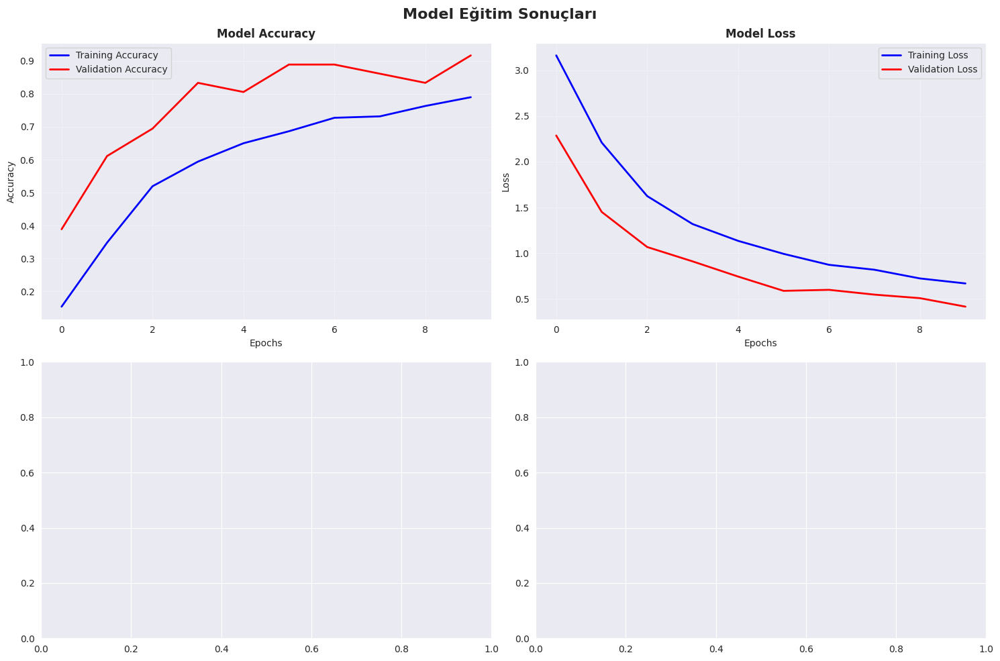


📈 EĞİTİM SONUÇLARI
En İyi Validation Accuracy: 0.9167
En İyi Validation Loss: 0.4159
En İyi Epoch: 10


In [29]:
def plot_training_history(history):
    """Eğitim geçmişini görselleştirir"""
    
    # Metrikleri al
    acc = history.history['accuracy']
    val_acc = history.history['val_accuracy']
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    
    epochs_range = range(len(acc))
    
    # Subplot oluştur
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle('Model Eğitim Sonuçları', fontsize=16, fontweight='bold')
    
    # Accuracy plot
    axes[0, 0].plot(epochs_range, acc, label='Training Accuracy', color='blue', linewidth=2)
    axes[0, 0].plot(epochs_range, val_acc, label='Validation Accuracy', color='red', linewidth=2)
    axes[0, 0].set_title('Model Accuracy', fontweight='bold')
    axes[0, 0].set_xlabel('Epochs')
    axes[0, 0].set_ylabel('Accuracy')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)
    
    # Loss plot
    axes[0, 1].plot(epochs_range, loss, label='Training Loss', color='blue', linewidth=2)
    axes[0, 1].plot(epochs_range, val_loss, label='Validation Loss', color='red', linewidth=2)
    axes[0, 1].set_title('Model Loss', fontweight='bold')
    axes[0, 1].set_xlabel('Epochs')
    axes[0, 1].set_ylabel('Loss')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3)
    
    # Learning rate plot (eğer varsa)
    if 'lr' in history.history:
        axes[1, 0].plot(epochs_range, history.history['lr'], color='green', linewidth=2)
        axes[1, 0].set_title('Learning Rate', fontweight='bold')
        axes[1, 0].set_xlabel('Epochs')
        axes[1, 0].set_ylabel('Learning Rate')
        axes[1, 0].set_yscale('log')
        axes[1, 0].grid(True, alpha=0.3)
    
    # Precision ve Recall
    if 'precision' in history.history:
        axes[1, 1].plot(epochs_range, history.history['precision'], label='Training Precision', color='purple', linewidth=2)
        axes[1, 1].plot(epochs_range, history.history['val_precision'], label='Validation Precision', color='orange', linewidth=2)
        axes[1, 1].plot(epochs_range, history.history['recall'], label='Training Recall', color='brown', linewidth=2)
        axes[1, 1].plot(epochs_range, history.history['val_recall'], label='Validation Recall', color='pink', linewidth=2)
        axes[1, 1].set_title('Precision & Recall', fontweight='bold')
        axes[1, 1].set_xlabel('Epochs')
        axes[1, 1].set_ylabel('Score')
        axes[1, 1].legend()
        axes[1, 1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.show()
    
    # En iyi sonuçları yazdır
    best_val_acc = max(val_acc)
    best_val_loss = min(val_loss)
    best_epoch = val_acc.index(best_val_acc) + 1
    
    print(f"\n📈 EĞİTİM SONUÇLARI")
    print("=" * 40)
    print(f"En İyi Validation Accuracy: {best_val_acc:.4f}")
    print(f"En İyi Validation Loss: {best_val_loss:.4f}")
    print(f"En İyi Epoch: {best_epoch}")

# Eğitim sonuçlarını görselleştir
plot_training_history(history)